<a href="https://colab.research.google.com/github/zyythn/training-model-yolo/blob/main/train_yolo11_pylon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [17]:
!pip install ultralytics --no-cache-dir


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 47.2 MB/s eta 0:00:00


In [6]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
!ls /content/drive/MyDrive/pylon


classes.txt  images  labels  notes.json


In [9]:
import os, shutil

SRC = "/content/drive/MyDrive/pylon"
DST = "/content/drive/MyDrive/pylon_labeled"

os.makedirs(f"{DST}/images", exist_ok=True)
os.makedirs(f"{DST}/labels", exist_ok=True)

imgs = os.listdir(f"{SRC}/images")

kept = 0
for img in imgs:
    name = img.rsplit('.',1)[0]
    lbl = f"{SRC}/labels/{name}.txt"
    if os.path.exists(lbl):
        shutil.copy(f"{SRC}/images/{img}", f"{DST}/images/{img}")
        shutil.copy(lbl, f"{DST}/labels/{name}.txt")
        kept += 1

print(f"Copied {kept} labeled images")


Copied 101 labeled images


In [ ]:
import os, random, shutil

BASE = "/content/drive/MyDrive/pylon_labeled"
IMG = f"{BASE}/images"
LBL = f"{BASE}/labels"

for s in ["train", "val"]:
    os.makedirs(f"{IMG}/{s}", exist_ok=True)
    os.makedirs(f"{LBL}/{s}", exist_ok=True)

files = [f for f in os.listdir(IMG) if f.endswith((".jpg",".png",".jpeg"))]
random.shuffle(files)

cut = int(0.8 * len(files))

def move(flist, split):
    for f in flist:
        shutil.move(f"{IMG}/{f}", f"{IMG}/{split}/{f}")
        shutil.move(f"{LBL}/{f.rsplit('.',1)[0]}.txt", f"{LBL}/{split}/{f.rsplit('.',1)[0]}.txt")

move(files[:cut], "train")
move(files[cut:], "val")



Archive:  pylon.zip
replace classes.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: classes.txt             
  inflating: notes.json              
  inflating: labels/DJI_20221123104117_0020_Z.txt  
  inflating: labels/DJI_20221123104356_0031_Z.txt  
  inflating: labels/DJI_20221123104717_0047_Z.txt  
  inflating: labels/DJI_20221123104101_0018_Z.txt  
  inflating: labels/DJI_20221123104222_0027_W.txt  
  inflating: labels/DJI_20221123104442_0037_Z.txt  
  inflating: labels/DJI_20221123104219_0026_Z.txt  
  inflating: labels/DJI_20221123104355_0031_W.txt  
  inflating: labels/DJI_20221123104821_0054_W.txt  
  inflating: labels/DJI_20221123104206_0024_W.txt  
  inflating: labels/DJI_20221123103839_0005_W.txt  
  inflating: labels/DJI_20221123104800_0051_W.txt  
  inflating: labels/DJI_20221123104346_0029_W.txt  
  inflating: labels/DJI_20221123104441_0037_W.txt  
  inflating: labels/DJI_20221123104027_0016_W.txt  
  inflating: labels/DJI_20221123104414_0033_W.txt  
  inflating

In [11]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Correct paths (Google Drive)
images_path = "/content/drive/MyDrive/pylon/images"
labels_path = "/content/drive/MyDrive/pylon/labels"
base_path   = "/content/drive/MyDrive/pylon_labeled"  # new clean dataset

# Create train/val folders
for folder in ["images/train", "images/val", "labels/train", "labels/val"]:
    os.makedirs(os.path.join(base_path, folder), exist_ok=True)

# List ONLY images that have matching labels
all_images = []
for f in os.listdir(images_path):
    if f.lower().endswith((".jpg", ".png", ".jpeg")):
        label = f.rsplit(".", 1)[0] + ".txt"
        if os.path.exists(os.path.join(labels_path, label)):
            all_images.append(f)

print(f"Total labeled images found: {len(all_images)}")

# Split train/val
train_imgs, val_imgs = train_test_split(all_images, test_size=0.2, random_state=42)

# Copy images and labels
for img_list, split in [(train_imgs, "train"), (val_imgs, "val")]:
    for img in img_list:
        shutil.copy(
            os.path.join(images_path, img),
            os.path.join(base_path, f"images/{split}/{img}")
        )

        label_file = img.rsplit(".", 1)[0] + ".txt"
        shutil.copy(
            os.path.join(labels_path, label_file),
            os.path.join(base_path, f"labels/{split}/{label_file}")
        )


Total labeled images found: 101


In [12]:
!ls /content/drive/MyDrive/pylon_labeled/images/train | head
!ls /content/drive/MyDrive/pylon_labeled/labels/train | head


DJI_20221123103538_0002_W.JPG
DJI_20221123103649_0003_W.JPG
DJI_20221123103833_0004_W.JPG
DJI_20221123103841_0006_W.JPG
DJI_20221123103845_0007_W.JPG
DJI_20221123103851_0008_W.JPG
DJI_20221123103917_0009_W.JPG
DJI_20221123103918_0010_W.JPG
DJI_20221123103959_0011_Z.JPG
DJI_20221123104003_0012_Z.JPG
DJI_20221123103538_0002_W.txt
DJI_20221123103649_0003_W.txt
DJI_20221123103833_0004_W.txt
DJI_20221123103841_0006_W.txt
DJI_20221123103845_0007_W.txt
DJI_20221123103851_0008_W.txt
DJI_20221123103917_0009_W.txt
DJI_20221123103918_0010_W.txt
DJI_20221123103959_0011_Z.txt
DJI_20221123104003_0012_Z.txt


In [19]:
import yaml
from ultralytics import YOLO

# Define paths
base_path = "/content/drive/MyDrive/pylon_labeled"
classes_file = "/content/drive/MyDrive/pylon/classes.txt"
data_yaml_path = "data.yaml" # This will be created in the current working directory

# Read class names from classes.txt
with open(classes_file, "r") as f:
    class_names = [line.strip() for line in f if line.strip()]

# Create data.yaml content
data_config = {
    "train": f"{base_path}/images/train",
    "val": f"{base_path}/images/val",
    "nc": len(class_names),
    "names": class_names,
}

# Write data.yaml file
with open(data_yaml_path, "w") as f:
    yaml.dump(data_config, f, default_flow_style=False)

print(f"'{data_yaml_path}' created successfully with content:\n{yaml.dump(data_config)}")

model = YOLO("yolo11n.pt")
model.train(
    data=data_yaml_path, # Use the path to the newly created data.yaml
    epochs=50,
    imgsz=640,
    batch=16,
    name="pylon_yolo11"
)


'data.yaml' created successfully with content:
names:
- damper
- insulator
- insulator plate
- plate separator
- pylon tower
nc: 5
train: /content/drive/MyDrive/pylon_labeled/images/train
val: /content/drive/MyDrive/pylon_labeled/images/val

Ultralytics 8.4.7 🚀 Python-3.12.12 torch-2.9.0+cpu CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300,

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ba4bf3e5640>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

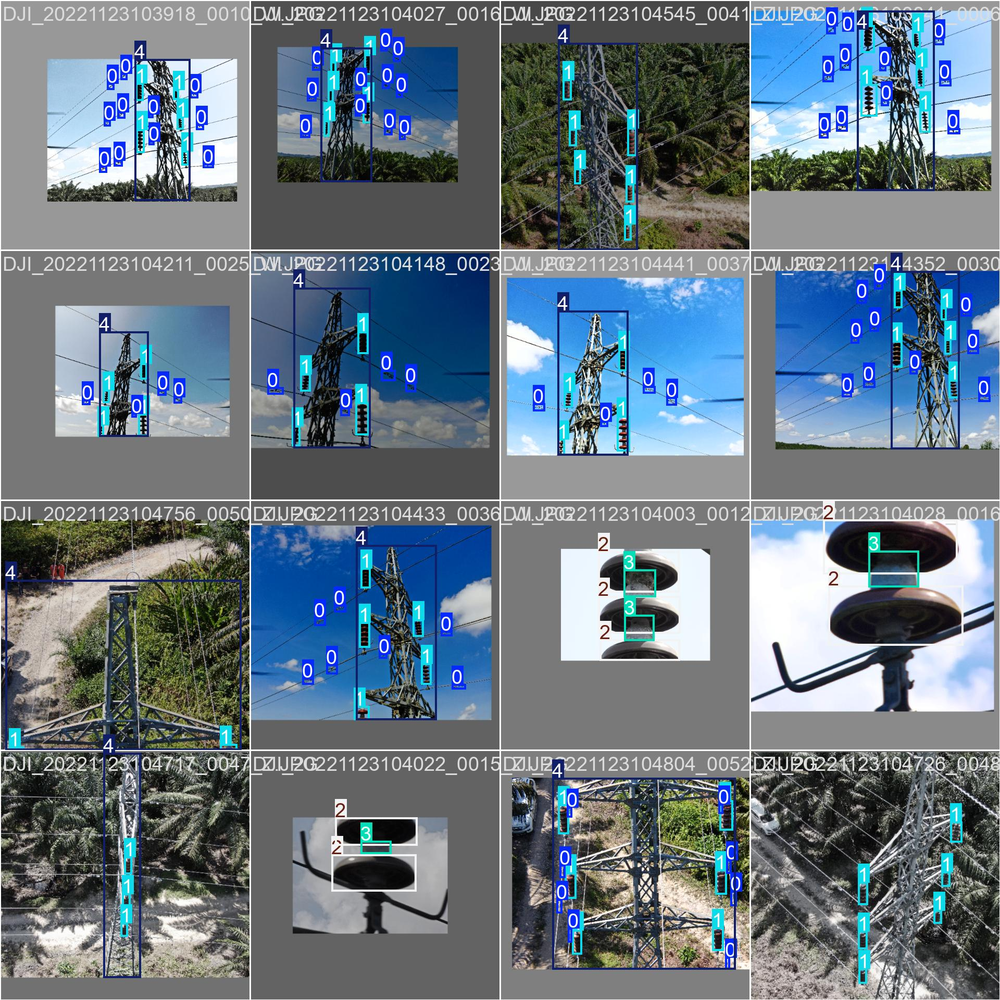

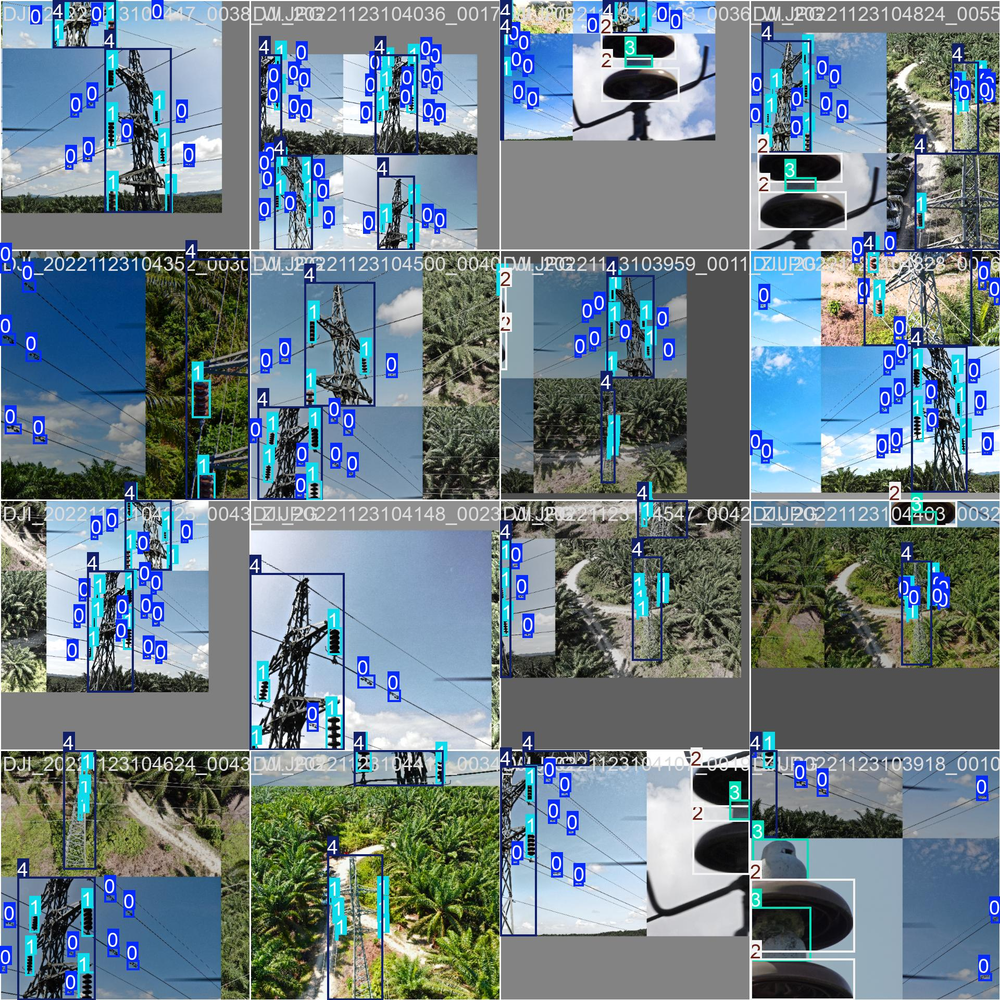

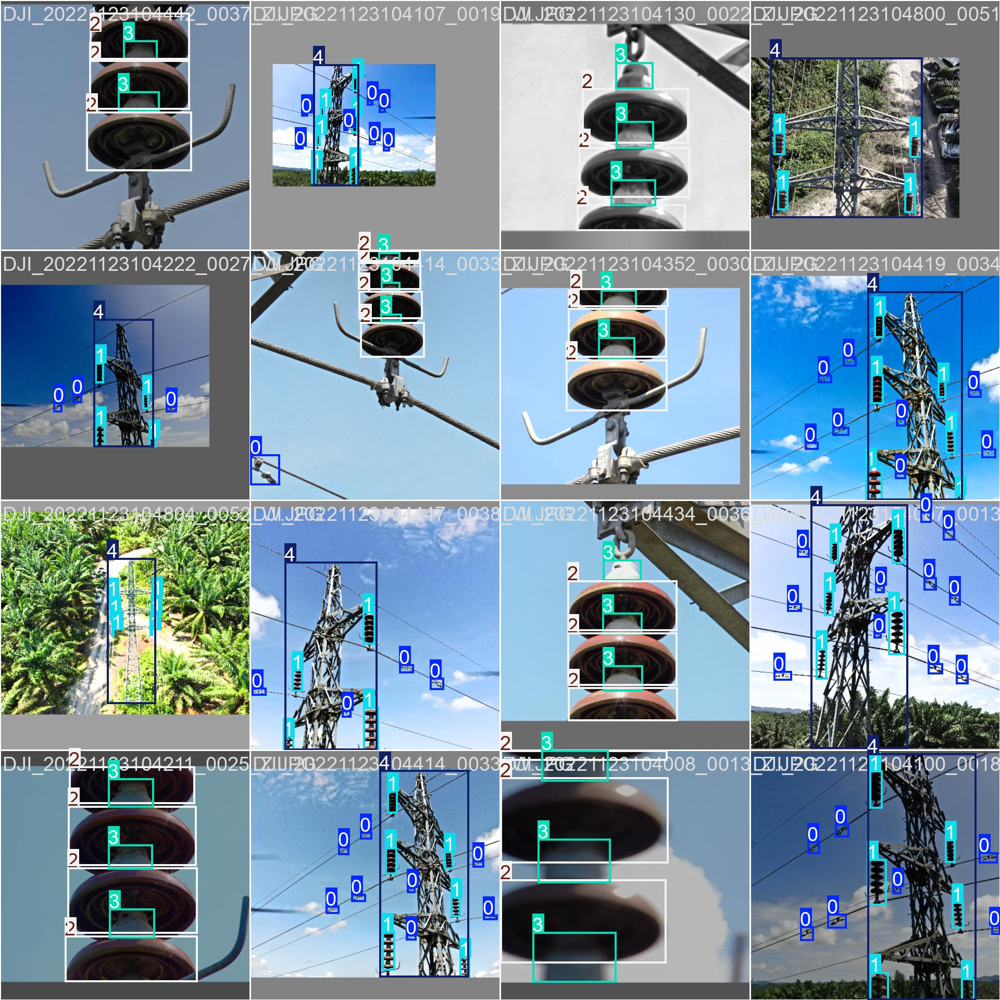

In [21]:
import glob
import os
from IPython.display import Image as IPyImage, display

# Get the latest prediction folder
latest_folder = max(glob.glob(f'/content/runs/detect/pylon_yolo11*/'), key=os.path.getmtime)

# Display first 3 images
for img in glob.glob(f'{latest_folder}/*.jpg')[:3]:
    display(IPyImage(filename=img, width=600))
    print("\n")

In [24]:
from ultralytics import YOLO

# Load your trained model
model = YOLO("/content/runs/detect/pylon_yolo112/weights/best.pt")


In [27]:
# Path to the image(s) you want to predict
image_path = "/content/drive/MyDrive/pylon_labeled/images/val/DJI_20221123104637_0044_Z.JPG"  # Example: using an image from your validation set
# or for a folder: "/content/test_images/*.jpg"

# Run prediction
results = model.predict(source=image_path, save=True)  # save=True stores results in runs/detect/


image 1/1 /content/drive/MyDrive/pylon_labeled/images/val/DJI_20221123104637_0044_Z.JPG: 480x640 1 damper, 5 insulators, 1 pylon tower, 171.2ms
Speed: 5.1ms preprocess, 171.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
Results saved to /content/runs/detect/predict


Showing images from: /content/runs/detect/predict



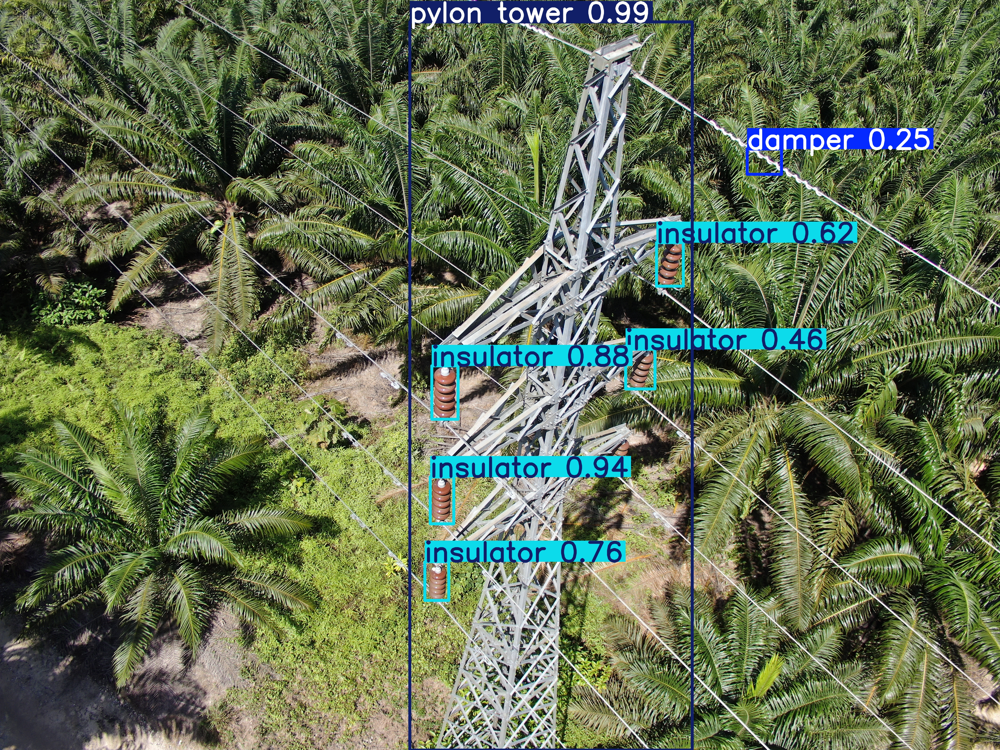

In [28]:
from IPython.display import Image as IPyImage, display
import glob
import os

# Get the latest prediction folder
latest_folder = max(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
print(f"Showing images from: {latest_folder}\n")

# Display all images (or first 3)
for img in glob.glob(f'{latest_folder}/*.jpg')[:3]:
    display(IPyImage(filename=img, width=600))
